In [27]:
import torch
from torch.utils.data import Dataset,DataLoader
from torchvision import transforms 
# from dataloader.dataloader_RGB_Depth import CISIA_SURF
import pandas as pd

In [77]:
from PIL import Image
import os
import cv2
import torch
import numpy as np
from torch.utils.data import Dataset,DataLoader
from torchvision import transforms 
from torch.utils.data.sampler import SubsetRandomSampler, RandomSampler
import pdb

class CISIA_SURF(Dataset):

    def __init__(self, metadata_root = '/mnt/nas3/yrkim/liveness_lidar_project/GC_project/code/metadata/', 
                        data_root = '/mnt/nas3/yrkim/liveness_lidar_project/GC_project/data/' , datatxt = '', transform=None):
        self.metadata_root = metadata_root 
        self.data_root = data_root
        self.transform = transform
        self.img_paths = []
        self.rgb_paths = []
        self.depth_paths = []
        self.labels = []

        lines_in_txt = open(os.path.join(metadata_root,datatxt),'r')

        for line in lines_in_txt:
            line = line.rstrip() 
            split_str = line.split()
            rgb_path = os.path.join(data_root,split_str[0])
            depth_path = os.path.join(data_root,split_str[1])
            label = split_str[2] 
            self.rgb_paths.append(rgb_path)
            self.depth_paths.append(depth_path)

            self.labels.append(label)

    def __getitem__(self,index):
        rgb_path = self.rgb_paths[index]
        depth_path = self.depth_paths[index]
        rgb_img = Image.open(rgb_path).convert('RGB')
        depth_img = Image.open(depth_path).convert('RGB')

        if self.transform is not None:
            rgb_img = self.transform(rgb_img)
            depth_img = self.transform(depth_img)

        label = torch.as_tensor(int(self.labels[index]))
        
        return rgb_img,depth_img,label, rgb_path,depth_path

    def __len__(self):
        return len(self.rgb_paths)


In [78]:
train_transforms = transforms.Compose([
    transforms.Resize((124,124)),
    transforms.CenterCrop((80,80)),
    transforms.ToTensor(),
    transforms.Normalize([0.5,0.5,0.5],[0.5,0.5,0.5])
])

val_transforms = transforms.Compose([
    transforms.Resize((124,124)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomCrop(112, padding=5),
    transforms.ToTensor(),
    # transforms.Normalize([0.5,0.5,0.5],[0.5,0.5,0.5])
])

train_data=CISIA_SURF(datatxt='MakeTextFileCode_RGB_Depth/train_data_list.txt', transform=train_transforms)
test_data=CISIA_SURF(datatxt='MakeTextFileCode_RGB_Depth/test_data_list.txt', transform=train_transforms)

print(len(train_data))
print(len(test_data))

5580
2520


In [79]:
train_loader = DataLoader(dataset=train_data, batch_size=2000, shuffle=True, num_workers=32)
test_loader = DataLoader(dataset=test_data, batch_size=32, shuffle = False, num_workers=32)
len(train_loader)

3

In [72]:
from PIL import Image

real_paths,mask_paths=[],[]
for i,data in enumerate(train_loader) :
    rgb_img = data[0]
    depth_img = data[1]
    labels = data[2]
    
    for b in range(len(data[3])) :
        if 'real' in data[3][b] :
            real_paths.append(data[3][b])
        elif 'attack' in data[3][b] :
            mask_paths.append(data[3][b])
            
    break

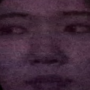

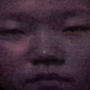

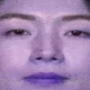

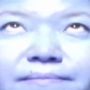

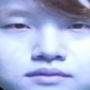

...

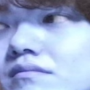

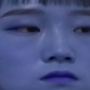

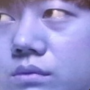

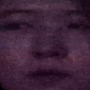

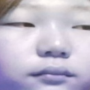

976


In [73]:
real_dist = []
crop=transforms.Compose([
    transforms.Resize((124,124)),
    transforms.CenterCrop((90,90))])
for i in real_paths :
    img = cv2.imread(i)
    img = crop(Image.fromarray(img))
    img = np.array(img)
    real_dist.append(img.flatten().tolist())
    img = Image.fromarray(img)
    display(img)
real_dist = sum(real_dist,[])
print(len(real_paths))

(array([ 697390., 2214825., 2880980., 2081755., 1675704., 1525443.,
        2035245., 2528131., 2803420., 5273907.]),
 array([  0. ,  25.5,  51. ,  76.5, 102. , 127.5, 153. , 178.5, 204. ,
        229.5, 255. ]),
 <BarContainer object of 10 artists>)

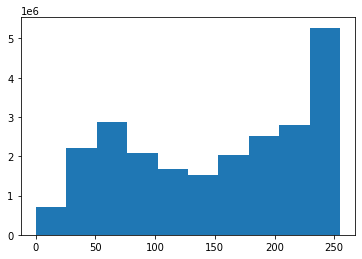

In [74]:
import matplotlib.pyplot as plt
plt.hist(real_dist)

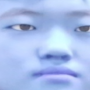

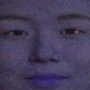

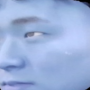

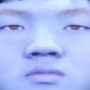

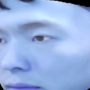

...

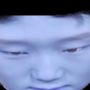

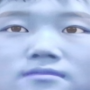

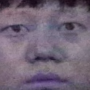

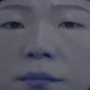

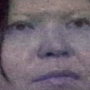

1024


In [75]:
mask_dist = []

for i in mask_paths :
    img = cv2.imread(i)
    img = crop(Image.fromarray(img))
    img = np.array(img)
    mask_dist.append(img.flatten().tolist())
    img = Image.fromarray(img)
    display(img)
mask_dist = sum(mask_dist,[])
print(len(mask_paths))

In [76]:
import matplotlib.pyplot as plt
plt.hist(mask_dist)

(array([ 389513., 1118517., 4144725., 4351632., 3236382., 2323004.,
        2667855., 2438719., 1840490., 2372363.]),
 array([  0. ,  25.5,  51. ,  76.5, 102. , 127.5, 153. , 178.5, 204. ,
        229.5, 255. ]),
 <BarContainer object of 10 artists>)

In [5]:
train_loader = DataLoader(dataset=train_data, batch_size=32, shuffle=True, num_workers=32)

rgb_paths_T,depth_paths_T,labs_T = [],[],[]
for i,data in enumerate(train_loader) :
    rgb_img = data[0]
    depth_img = data[1]
    labels = data[2]
    
    for b in range(len(data[3])) :
        rgb_paths_T.append(data[3][b])
        depth_paths_T.append(data[4][b])
        labs_T.append(data[2][b])

train_loader = DataLoader(dataset=train_data, batch_size=32, shuffle=False, num_workers=32)

rgb_paths_F,depth_paths_F,labs_F = [],[],[]
for i,data in enumerate(train_loader) :
    rgb_img = data[0]
    depth_img = data[1]
    labels = data[2]
    
    for b in range(len(data[3])) :
        rgb_paths_F.append(data[3][b])
        depth_paths_F.append(data[4][b])
        labs_F.append(data[2][b])

In [26]:
import random
train_random_idx = list(range(len(train_data)))
test_random_idx = list(range(len(test_data)))

random.shuffle(train_random_idx)
random.shuffle(test_random_idx)

np.save('./train_random_idx.npy',np.array(train_random_idx))
np.save('./test_random_idx.npy',np.array(test_random_idx))

In [24]:
[rgb_paths_T[i] for i in my_random_idx]

['/mnt/nas3/yrkim/liveness_lidar_project/GC_project/data/Training/10/KINECT/Light_02_Mid/real_01/color/crop/014.jpg',
 '/mnt/nas3/yrkim/liveness_lidar_project/GC_project/data/Training/8/KINECT/Light_01_High/real_01/color/crop/007.jpg',
 '/mnt/nas3/yrkim/liveness_lidar_project/GC_project/data/Training/9/KINECT/Light_03_Low/real_01/color/crop/011.jpg',
 '/mnt/nas3/yrkim/liveness_lidar_project/GC_project/data/Training/30/KINECT/Light_03_Low/attack_07_3d_mask/color/crop/025.jpg',
 '/mnt/nas3/yrkim/liveness_lidar_project/GC_project/data/Training/9/KINECT/Light_01_High/attack_07_3d_mask/color/crop/004.jpg',
 '/mnt/nas3/yrkim/liveness_lidar_project/GC_project/data/Training/5/KINECT/Light_02_Mid/real_01/color/crop/006.jpg',
 '/mnt/nas3/yrkim/liveness_lidar_project/GC_project/data/Training/4/KINECT/Light_01_High/attack_07_3d_mask/color/crop/004.jpg',
 '/mnt/nas3/yrkim/liveness_lidar_project/GC_project/data/Training/9/KINECT/Light_02_Mid/real_01/color/crop/010.jpg',
 '/mnt/nas3/yrkim/liveness_li

In [20]:
metadata_root = '/mnt/nas3/yrkim/liveness_lidar_project/GC_project/code/metadata/'
data_root = '/mnt/nas3/yrkim/liveness_lidar_project/GC_project/data/'
datatxt='MakeTextFileCode_RGB_Depth/train_data_list.txt'
rgb_paths = []
depth_paths = []
labels = []


lines_in_txt = open(os.path.join(metadata_root,datatxt),'r')

for line in lines_in_txt:
    line = line.rstrip() 
    split_str = line.split()
    rgb_path = os.path.join(data_root,split_str[0])
    depth_path = os.path.join(data_root,split_str[1])
    label = split_str[2] 
    rgb_paths.append(rgb_path)
    depth_paths.append(depth_path)

    labels.append(label)


In [21]:
len(rgb_paths)

5580

In [123]:
df_T=pd.DataFrame({'rgb_path_T':rgb_paths_T,'depth_path_T':rgb_paths_T,'label_T':labs_T})
df_F=pd.DataFrame({'rgb_path_F':rgb_paths_F,'depth_path_F':rgb_paths_F,'label_F':labs_F})
display(df_T.head(3))
display(df_F.head(3))

,rgb_path_T,depth_path_T,label_T
0,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1)
1,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1)
2,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)


,rgb_path_F,depth_path_F,label_F
0,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
1,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
2,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)


In [124]:
df_T=df_T.sort_values('rgb_path_T').reset_index(drop=True)
df_F=df_F.sort_values('rgb_path_F').reset_index(drop=True)

full_df = pd.concat([df_T,df_F],axis=1)

In [125]:
df_T

,rgb_path_T,depth_path_T,label_T
0,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
1,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
2,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
3,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
4,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
...,...,...,...
5575,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1)
5576,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1)
5577,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1)
5578,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1)


In [126]:
full_df

,rgb_path_T,depth_path_T,label_T,rgb_path_F,depth_path_F,label_F
0,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0),/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
1,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0),/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
2,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0),/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
3,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0),/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
4,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0),/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
...,...,...,...,...,...,...
5575,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1),/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1)
5576,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1),/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1)
5577,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1),/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1)
5578,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1),/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1)


In [114]:
same=[]
for i in range(len(full_df)) :
    c1=full_df.iloc[i]['rgb_path_T']==full_df.iloc[i]['rgb_path_F']
    c2=full_df.iloc[i]['depth_path_T']==full_df.iloc[i]['depth_path_F']
    c3=int(full_df.iloc[i]['label_T'])==int(full_df.iloc[i]['label_F'])
    
    same.append([c1,c2,c3])
    
#     break

In [118]:
sum([same[i][0] for i in range(len(same))])

5580

In [120]:
sum([same[i][1] for i in range(len(same))])

5580

In [121]:
sum([same[i][2] for i in range(len(same))])

5580

In [119]:
len(full_df)

5580

In [79]:
df_T.iloc[0][0]

'/mnt/nas3/yrkim/liveness_lidar_project/GC_project/data/Training/1/KINECT/Light_01_High/attack_07_3d_mask/color/crop/001.jpg'

In [80]:
df_F.iloc[0][0]

'/mnt/nas3/yrkim/liveness_lidar_project/GC_project/data/Training/1/KINECT/Light_01_High/attack_07_3d_mask/color/crop/001.jpg'

In [81]:
df_T

,rgb_path,depth_path,label
771,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
2749,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
43,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
737,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
4122,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(0)
...,...,...,...
4197,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1)
71,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1)
1446,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1)
5327,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,/mnt/nas3/yrkim/liveness_lidar_project/GC_proj...,tensor(1)


In [35]:
attack,real = [],[]
for i,data in enumerate(train_loader) :
    rgb_img = data[0]
    depth_img = data[1]
    labels = data[2]
    rgb_paths = data[3]
    depth_paths = data[4]
    
    for b in range(len(depth_paths)) :
        if 'attack' in depth_paths[b] :
            attack.append([rgb_paths[b],depth_paths[b],labels[b]])
        elif 'real' in depth_paths[b] :
            real.append([rgb_paths[b],depth_paths[b],labels[b]])

#     break

In [36]:
attack_check = [int(attack[i][2]) for i in range(len(attack))]
real_check = [int(real[i][2]) for i in range(len(real))]

print(sum(attack_check))
print(sum(real_check))

0
2790


In [37]:
5580/2

2790.0

In [44]:
# train_transforms = transforms.Compose([
#     transforms.Resize((124,124)),
#     transforms.CenterCrop((112,112)),
#     transforms.ToTensor(),
#     transforms.Normalize([0.5,0.5,0.5],[0.5,0.5,0.5])
# ])

val_transforms = transforms.Compose([
    transforms.Resize((124,124)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomCrop(112, padding=5),
    transforms.ToTensor(),
    # transforms.Normalize([0.5,0.5,0.5],[0.5,0.5,0.5])
])

train_data=CISIA_SURF(datatxt='MakeTextFileCode_RGB_Depth/train_data_list.txt', transform=None)
test_data=CISIA_SURF(datatxt='MakeTextFileCode_RGB_Depth/test_data_list.txt', transform=None)


In [45]:

train_loader = DataLoader(dataset=train_data, batch_size=64, shuffle = True, num_workers=32)
test_loader = DataLoader(dataset=test_data, batch_size=32, shuffle = False, num_workers=32)


In [53]:
for i,data in enumerate(train_loader) :
    rgb_img = data[0]
    depth_img = data[1]
    labels = data[2]

    
    for b in range(rgb_img.shape[0]) :
        print(rgb_img[b].shape)
        print(labels[b])
        img = Image.fromarray(rgb_img[b].permute(1,2,0).numpy())
        display(img)
    
    break

TypeError: Caught TypeError in DataLoader worker process 0.
Original Traceback (most recent call last):
  File "/home/kok/anaconda3/envs/clothes/lib/python3.7/site-packages/torch/utils/data/_utils/worker.py", line 287, in _worker_loop
    data = fetcher.fetch(index)
  File "/home/kok/anaconda3/envs/clothes/lib/python3.7/site-packages/torch/utils/data/_utils/fetch.py", line 52, in fetch
    return self.collate_fn(data)
  File "/home/kok/anaconda3/envs/clothes/lib/python3.7/site-packages/torch/utils/data/_utils/collate.py", line 84, in default_collate
    return [default_collate(samples) for samples in transposed]
  File "/home/kok/anaconda3/envs/clothes/lib/python3.7/site-packages/torch/utils/data/_utils/collate.py", line 84, in <listcomp>
    return [default_collate(samples) for samples in transposed]
  File "/home/kok/anaconda3/envs/clothes/lib/python3.7/site-packages/torch/utils/data/_utils/collate.py", line 86, in default_collate
    raise TypeError(default_collate_err_msg_format.format(elem_type))
TypeError: default_collate: batch must contain tensors, numpy arrays, numbers, dicts or lists; found <class 'PIL.Image.Image'>


In [47]:
from PIL import Image

In [48]:
rgb_img.shape

torch.Size([64, 3, 112, 112])

In [49]:
rgb_img[b].permute(1,2,0).numpy().shape

(112, 112, 3)

In [50]:
rgb_img[b]

tensor([[[-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000],
         [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000],
         [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -0.9922],
         ...,
         [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000],
         [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000],
         [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -0.9922]],

        [[-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000],
         [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000],
         [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000],
         ...,
         [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -0.9922, -1.0000],
         [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000],
         [-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000]],

        [[-1.0000, -1.0000, -1.0000,  ..., -1.0000, -1.0000, -1.0000],
         [-1.0000, -1.0000, -1.0000,  ..., -1